# Tropical Gaussians

- Proseminar *Ultrametric Data Analysis* SoSe25
- A Presentation by **Soroush Yaghoubi**

In [1]:
import plotly.io as pio
pio.renderers.default = "notebook_connected"


# Introduction

> **GOAL**: "Tropical Gaussians"

1. <span class="fragment"> reviewing p-adics *(only the parts we care about)* </span>
2. <span class="fragment"> p-adics $\longrightarrow$ Tropical Math </span>
3. <span class="fragment"> a cool usecase: *Neural Networks* </span>
4. <span class="fragment"> reviewing nice properties of Gaussian distributions </span>
5. <span class="fragment"> $\longrightarrow$ a distribution over the p-adic tropicalization </span>



Welcome to the presentation Tropical Gaussians! Our goal today is to show how we can creatively use p-adics as a tool to create nice distributions in the tropical setting. This is of course a mouthful so here is an overview:
1. First we review p-adics only from an angle that is useful to us.
2. In the second part we will see how you can use the p-adics to step into the tropical setting! This is of course where we also introduce some tropical topics like Tropical Geometry, Tropical Algebra and Tropicalization.
3. Then as an example we will look at a usecase of tropicalization in neural networks. 
4. In the end we will take a look at some nice properties of the Gaussian distribution and then try to build a distribution that may or may not have those nice properties. 🤠

## 1. Reviewing $p$-adics
<div>
    <img src="staticResources/viz1.png" width="20%" style="display:inline;" />
    <img src="staticResources/viz2.png" width="20%" style="display:inline;" />
    <img src="staticResources/viz3.png" width="20%" style="display:inline;" />
    <img src="staticResources/viz4.png" width="20%" style="display:inline;" />

</div>

Now there are several way you could go about defining what Tropical Geometry is. But since we are already in the context of p-adics let’s start building the idea from bottom up together in a way that would make sense rather than taking a formal defintion out of thin air.

Before we do that I assume you are familiar with some properties and tools used in the p-adic setting. But let’s do a half intuitive half mathematical recap what these tools are.

## *Picking the Right Visualization*

First of all there are very many different ways you could visualize a mathematical object and p-adic numbers might be one of the strangest ones. One thing that’s clear is none of these visualizations depict all of the properties of the p-adics. For our purposes let’s take this particular way of visualization that highlights the properties that we care about: a fractal where there are infinite spheres nested inside of each other.

Imagine we want to organize all numbers into these nested balls. First we find all the multiples of p
. Any number left will stay in the current ball. In order to organize the multiples of p we peel the next layer again. Then again we find all of the numbers that are multiples of p2
. Any residues of p2
 stays here. We can continues like this forever until we put every single integer where it should be.

In [11]:
from IPython.display import Video
Video("staticResources/organizingPAdics.mp4", embed=True, height=550)

## *Why don't the other visualizations work?*

<div>
<img src="staticResources/commonPAdics.png" width="550">
</div>


This image is a very common way of visualizing p-adics. One piece of information that is lost here is how deep you should go before you find a number. In this image it seems like all the residue classes introduce the same notion of depth.



## the _valuation_ function

$$v_3(36)=v_3(3^{\boxed{2}} \times 4)=2$$

This operation of peeling aka going one layer deeper into this sphere is infact so important that there is a function defined just for that, called the valuation function. This valuation function that is noted as $v_p$ is in essence counting how many times you have to open the balls before you can find your number.

As an example take number 36 in the 3-adics. The "valuation" of this number is $v_3(36)=v_3(3^{\boxed{2}} \times 4)=2$ because the highest power of 3 that divides 36 is 2. More intuitively this means that number 36 is not findable in the unit layer and not in the 1st layer but after we open up 2 nested balls.

> Before we continue we have to also mention some small details. The valuation of number 0 is by convention infinity and for us that means we can only find 0 by peeling infinitely many times. 
> Also the valuation function is extended and defined on all rational numbers with the same idea and also it ignores the sign of the number. For example number $-\frac{15}{36}$ would have the valuation $\frac{3^1 \times 5}{3^2 \times 4} = 3^{\boxed{-1}} \times \frac{5}{4}=-1$. What this topologically means is beyond this introduction but think if it as doing the opposite of openning the balls.

$$v_p(-\frac{15}{36}) = v_3(\frac{3^1 \times 5}{3^2 \times 4}) = v_p(3^{\boxed{-1}} \times \frac{5}{4})=-1$$

___

$$v_p(0) := +\infty$$


# 2. Tropicalization

- Setup

$$x=p^{v_p(x)} \times a$$
$$y=p^{v_p(y)} \times b$$

___

$$X := v_p(x)$$
$$Y := v_p(y)$$

___

$$m:=\min(v_p(x), v_p(y))$$
$$M:=\max(v_p(x), v_p(y))$$

Now as the next step we will mechanically play around with some properties of the valuation. In simplest terms the question is: what happens when we try to find the valuation of two numbers multiplied or added together? 

Let's take two numbers x and y. Per definition we can write them as $p^{v_p(x)} \times a$ and $p^{v_p(y)} \times b$. We will also use these short notations: 
$m:=\min(v_p(x), v_p(y))$ and $M:=\max(v_p(x), v_p(y))$ Also we sometimes use capital letters for the valuation of a variable for example $X := v_p(x)$.

Take a look at these two properties:

## *Two Nice Properties*

1. $$\qquad v_p(x y) \qquad \;\;\;\;\, = \qquad v_p(p^{\boxed{v_p(x) + v_p(y)}} \times ab) \qquad = \qquad v_p(x)+v_p(y)$$
2. $$v_p(x+y) \qquad = \qquad v_p(p^{v_p(x)}a + p^{v_p(y)}b) \qquad \qquad = \qquad \qquad ??$$

It is not hard to see why the first property holds but the least we can say is that it is pretty nice. 
But the second property looks a bit trickier. However if we were lucky and the valuations where not the same then we get exactly the $\min$imum of the two valuations. If we are unlucky and they are the same then the factors could possibly add up to make a larger valuation.

## *What to do With the Second Property?*


case $v_p(x) \neq v_p(y) \qquad \longrightarrow$ $$v_p(\;\; p^{m} (\boxed{p^{M-m}a + b}) \;\;)= \qquad m$$

___

case $v_p(x) = v_p(y) \qquad \longrightarrow$ $$v_p(\;\; p^{m} (\boxed{a + b})\;\;) \qquad \;\,\geq \qquad m$$


So we saw that multiplication simply becomes addition and addition has nice properties when the valuations are the smae. Let's keep these two facts in mind!

Knowing all this we will now look at what happens if we apply the valuation function to this equation and then taking its valuation.

Let's take a step back and think what this means. This equation is asking us when exactly can the valuation of the sum of the individual terms be as big as possible. Well from what we have seen so far we know for sure that this is possible if and only if the valuation of the individual terms is equal. Otherwise the answer will stay finite. 
More concretely we first find the valuation of each term: 

## *a revealing example*

<span class="fragment">
    $$x^2y+3y+y^5=0$$
    $$v_3(x^2y + 3y + y^5)=v_3(0)=\infty$$
</span>

___

<span class="fragment">
    $$v_3(x^2y)=v_3(x \times x \times y)=X+X+Y=\boxed{2X+Y}$$ 
    $$v_3(3y)=v_3(3) + Y = \boxed{1+Y}$$
    $$v_3(y^5)=v_3(Y+Y+Y+Y+Y) = \boxed{5Y}$$
</span>

___

<span class="fragment">
    $$\min(2X+Y, 1+Y, 5Y)$$
</span>


Then we use a very common trick here which is that we draw $\min(2X+Y, 1+Y, 5Y)$. The folded lines correspond exactly to the solution space for when the valuations are the same. (As a sidenote here you can see that there isn't a huge difference between the $\max$ function and the $\min$ function). **This is very useful because we reduced the space of all solutions from 2d to 1d and from a nonlinear one to a linear one.**

#### Example 1: The whole plot

In [3]:
import numpy as np
import plotly.graph_objects as go

x = np.linspace(-2, 2, 800)
y = np.linspace(-2, 3, 1000)
X, Y = np.meshgrid(x, y)

functions = [
    2*X + Y,
    1 + Y,
    5*Y
]

stack = np.stack(functions)
Z = np.min(stack, axis=0)
active = np.argmin(stack, axis=0)
mask = np.zeros_like(active, dtype=bool)
mask[1:, :] |= active[1:, :] != active[:-1, :]
mask[:, 1:] |= active[:, 1:] != active[:, :-1]

fig = go.Figure()

fig.add_trace(go.Surface(
    x=x, y=y, z=Z,
    colorscale="Viridis",
    showscale=True,
    opacity=0.8
))

fig.add_trace(go.Scatter3d(
    x=X[mask], y=Y[mask], z=Z[mask],
    mode='markers',
    marker=dict(size=2, color='black'),
    name="Bends"
))

fig.update_layout(scene=dict(
    xaxis_title='X', yaxis_title='Y', zaxis_title='Z'
))

fig.update_layout(
    height=650,
)

fig.show()


/home/soroushyaghoubi/anaconda3/envs/ua/lib/python3.12/site-packages/plotly/io/_renderers.py:51: UserWarning:

Plotly version >= 6 requires Jupyter Notebook >= 7 but you have 6.5.7 installed.
 To upgrade Jupyter Notebook, please run `pip install notebook --upgrade`.



#### Example 1: The contour plot (the tropical shape)

In [4]:
import plotly.io as pio
pio.renderers.default = "notebook_connected"

import numpy as np
import plotly.graph_objects as go

##### > defining the x-y-z space
x = np.linspace(-2, 2, 800)
y = np.linspace(-2, 3, 1000)
X, Y = np.meshgrid(x, y)

##### > the tropical functions
functions = [
    2*X + Y,
    1 + Y,
    5*Y
]

##### suzie :> calculating the points where the contour lines are bending (the tropical shape basically)
stack = np.stack(functions)
Z = np.min(stack, axis=0)
active = np.argmin(stack, axis=0)
mask = np.zeros_like(active, dtype=bool)
mask[1:, :] |= active[1:, :] != active[:-1, :]
mask[:, 1:] |= active[:, 1:] != active[:, :-1]

##### > just plotting here
fig = go.Figure()

fig.add_trace(go.Contour(
    z=Z,
    x=x,
    y=y,
    ncontours=60,
    contours=dict(coloring="fill")
))

fig.add_trace(go.Scatter(
    x=X[mask],
    y=Y[mask],
    mode='markers',
    marker=dict(size=2, color='black'),
    name="Bends"
))

fig.show()

#### Example 2: The whole plot

In [5]:
import plotly.io as pio
pio.renderers.default = "notebook_connected"

import numpy as np
import plotly.graph_objects as go

x = np.linspace(-2, 2, 800)
y = np.linspace(-2, 3, 1000)
X, Y = np.meshgrid(x, y)

functions = [
    X + Y,
    X + 2*Y + 3,
    2*X + Y + 1,
    X + 5,
    3*Y,
    np.full_like(X, 7),
    -X + 4,
    -2*X + 0.5*Y,
    0.5*X - Y + 2,
    X - 3*Y + 6,
    -X - Y + 1
]

stack = np.stack(functions)
Z = np.min(stack, axis=0)
active = np.argmin(stack, axis=0)
mask = np.zeros_like(active, dtype=bool)
mask[1:, :] |= active[1:, :] != active[:-1, :]
mask[:, 1:] |= active[:, 1:] != active[:, :-1]

fig = go.Figure()

fig.add_trace(go.Surface(
    x=x, y=y, z=Z,
    colorscale="Viridis",
    showscale=True,
    opacity=0.8
))

fig.add_trace(go.Scatter3d(
    x=X[mask], y=Y[mask], z=Z[mask],
    mode='markers',
    marker=dict(size=2, color='black'),
    name="Bends"
))

fig.update_layout(scene=dict(
    xaxis_title='X', yaxis_title='Y', zaxis_title='Z'
))

fig.update_layout(
    height=650,
)

fig.show()

#### Example 2: The contour plot (the tropical shape)

In [6]:
import plotly.io as pio
pio.renderers.default = "notebook_connected"

import numpy as np
import plotly.graph_objects as go

##### > defining the x-y-z space
x = np.linspace(-2, 2, 800)
y = np.linspace(-2, 3, 1000)
X, Y = np.meshgrid(x, y)

##### > the tropical functions
functions = [
    X + Y,
    X + 2*Y + 3,
    2*X + Y + 1,
    X + 5,
    3*Y,
    np.full_like(X, 7),
    -X + 4,
    -2*X + 0.5*Y,
    0.5*X - Y + 2,
    X - 3*Y + 6,
    -X - Y + 1
]

##### suzie :> calculating the points where the contour lines are bending (the tropical shape basically)
stack = np.stack(functions)
Z = np.min(stack, axis=0)
active = np.argmin(stack, axis=0)
mask = np.zeros_like(active, dtype=bool)
mask[1:, :] |= active[1:, :] != active[:-1, :]
mask[:, 1:] |= active[:, 1:] != active[:, :-1]

##### > just plotting here
fig = go.Figure()

fig.add_trace(go.Contour(
    z=Z,
    x=x,
    y=y,
    ncontours=60,
    contours=dict(coloring="fill")
))

fig.add_trace(go.Scatter(
    x=X[mask],
    y=Y[mask],
    mode='markers',
    marker=dict(size=2, color='black'),
    name="Bends"
))

fig.show()

## *a quick usecase

A usecase for this is the Bézout's Theorem in Tropical Algebraic Geometry which says that the number of intersections between two tropical shapes is proportionate to the number of solutions to the initial system of equations. This is nice again because our problem is changed completely from a nonlinear one to a combinatorics one which is very different in nature.

In [7]:
import numpy as np
import plotly.graph_objects as go

# First set 
x = np.linspace(-5, 5, 1200)
y = np.linspace(-5, 5, 1200)
X, Y = np.meshgrid(x, y)
functions1 = [X+Y, X+2*Y+3, 2*X+Y+1, X+5, 3*Y, np.full_like(X,7),
              -X+4, -2*X+0.5*Y, 0.5*X-Y+2, X-3*Y+6, -X-Y+1]
stack1 = np.stack(functions1)
active1 = np.argmin(stack1, axis=0)
mask1 = np.zeros_like(active1, dtype=bool)
mask1[1:,:] |= active1[1:,:] != active1[:-1,:]
mask1[:,1:] |= active1[:,1:] != active1[:,:-1]

x1, y1 = X[mask1], Y[mask1]

# Second set
functions2 = [2*X+Y, 1+Y, 5*Y]
stack2 = np.stack(functions2)
active2 = np.argmin(stack2, axis=0)
mask2 = np.zeros_like(active2, dtype=bool)
mask2[1:,:] |= active2[1:,:] != active2[:-1,:]
mask2[:,1:] |= active2[:,1:] != active2[:,:-1]

x2, y2 = X[mask2], Y[mask2]

# Combined plot
fig = go.Figure()
fig.add_trace(go.Scatter(x=x1, y=y1, mode="markers",
                         marker=dict(size=3, color="red"),
                         name="First Tropical Shape"))
fig.add_trace(go.Scatter(x=x2, y=y2, mode="markers",
                         marker=dict(size=3, color="blue"),
                         name="Second Tropical Shape"))
fig.show()


Now this technique of linearization is so powerful that it has a name and it has its own mathematical field which is Tropicalization. The type of polynomials that are generated here always look like the minimum of several linear polynomials which are studied in the field of Tropical Algebra. The shapes created by them are also usually several lines connected with each other making tripod shapes which are studied in the Tropical Geometry which was formalized by a Brazilian mathematician called Imre Simon who named the field after his tropical ethnicity as a joke. :smiley: 

- usual shape of tropical polygons: ![](https://md.fachschaften.org/uploads/fce458ac-e06d-4f07-bf2f-7e495342468a.png)

Before we continue I would like to point out that what we did here had little to do with p-adics themselves but rather with two properties of the valuation function in p-adics. That is why tropicalization is a technique that is done in any mathematical space that has such a valuation function with these two mentioned properties. P-adics only come in play when we start interpretting the valuation itself.

# 3. ReLU [*Neural*] Networks: a Tropical Example

$$ReLU(x)=\max(0, x)$$

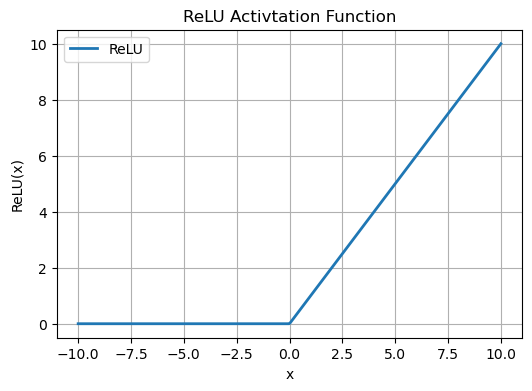

In [8]:
import numpy as np
import matplotlib.pyplot as plt

x = np.linspace(-10, 10, 400)
y = np.maximum(0, x)

plt.figure(figsize=(6, 4))
plt.plot(x, y, label="ReLU", linewidth=2)
plt.title("ReLU Activtation Function")
plt.xlabel("x")
plt.ylabel("ReLU(x)")
plt.grid()
plt.legend()
plt.show()


Another interesting field that could use Tropical Geometry is Neural Networks. In a neural network what basically is happening is a bunch of linear transformations chained together. But obviously chaining multiple linear transformations is just a single linear transformation. The usual way to solve this is by using a function after each linear transformation that introduces nonlinearity. These functions are called "Activation Functions". A popular activation function is ReLU which is just defined like the maximum of 0 and x. The main advantage here is that this function slightly introduced nonlinearity which then enables the neural network to capture more complicated patterns. But as we already know this is nothing but a tropical polynomial which is relatively well-studied compared to other activation functions.

# 4.1 Gaussians

- Stability under addition and scalar multiplication
- Invariance under rotations
- Independence of dimensions

Even though the field of Tropical Geometry is quite well studied, it is in fact a new one and in order to make a stronger framework out of it especially in a way that can help analyse machine learning it needs to be extended further. And as we all know machine learning is standing on the shoulders of statistics. So it is only natural to study statistical phenomena under the lens of tropicalization. 

If we had to name one single most important tool of statistics, it would be the Gaussian distribution. It has many useful properties but probably one of its most important properties would be that it is stable under linear transformations like addition. This means you can add or multiply a scalar into a random variable and it still keeps its general structure. This if of course not the only property that makes gaussians unique but also for example its invariance under rotation and independence of its coordinates and so on.


# 4.2 "*Tropical Gaussians*"

$$\mathbb{P}(\;\;v_p(X)=s\;\;) \qquad = \qquad (1/p)^s(1-1/p)$$

In [12]:
from IPython.display import Video
Video("staticResources/pAdicGaussians.mp4", embed=True, height=550)

But in the tropical setting there seems to be no way to create a distribution such that all the three nice properties of the Gaussians hold. But if we compromise a bit there is a nice way in which the p-adic valuation can yield a distribution that has the can stay stable under additions and scalar multiplication.

This is the research done by a statistician called Steven Evans. He describes a procedure from which a distribution with this property is made.

He first takes a random variable $X$. Then he p-adically tropicalizes it. We have seen of course that this is not more than taking the valuation of the random variable $v_p(X)$. He then tries to find the probability of this value being a certain number s: $$\mathbb{P}(\;\;v_p(X)=s\;\;) \qquad = \qquad ?$$

But now we know how to interpret this: what is the probability of a number being found after peeling exactly s number of spheres? As we talked about earlier we can only go one layer deeper if we open the sphere of the numbers divisible by the power of p. This means in each step out of the p spheres in front of us we can only open one of them. The probability of this is of course $1/p$. We then have to do this step s times which gives us $1/p^s$. After that we have to make sure that we don't end up going any deeper. This means choosing any sphere other than the one with numbers divisible by the power of p which there is only one of them. This has of course the probability $(1-1/p)$.

This overal probability is a geometric one which is studied well in statistics and is indeed closed under addition and scalar multiplication. $$(1/p^s)(1-1/p)$$

# Summary

So we defined what tropicalization means in the context of p-adics. But we also showed that it is not specific to p-adics but rather makes sense for all mathematical spaces with a valuation function with almost linear properties.
But then we showed that by specifically using the p-adic interpretation of the valuation we can create a geometric distribution which has some properties that we like.
We can then for example go on and use this as a tool for creating random input for a neural network that uses ReLU without ever needing to exit the tropical context.

# Open Directions

- Even more similarity with Gaussians
- Extending p-adics to more dimensions
- Useage of p-adic distributions for statistical inference

# References